In [1]:
import pandas as pd
import matplotlib as plt
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')
import requests
from datetime import datetime, timedelta
from tqdm import tqdm 
pd.options.display.float_format = '{:,.0f}'.format

# 01. Import Data

In [7]:
 

all_protocols = requests.get("https://api.llama.fi/protocols").json()

eth_protocols = [p for p in all_protocols if "Ethereum" in p.get("chains", [])]

print(f"✅ Number of all protocols on Ethereum: {len(eth_protocols)}")

one_year_ago = datetime.now() - timedelta(days=365)

all_data = []

for proto in tqdm(eth_protocols):
    name = proto["slug"]  # مثل 'aave'
    try:
        url = f"https://api.llama.fi/protocol/{name}"
        res = requests.get(url)
        if res.status_code != 200:
            continue

        data = res.json()
        tvl_data = data.get("chainTvls", {}).get("Ethereum", {}).get("tvl", [])
        if not tvl_data:
            continue

        df = pd.DataFrame(tvl_data)
        df['date'] = pd.to_datetime(df['date'], unit='s')
        df = df[df['date'] >= one_year_ago]
        df['tvl_usd'] = df['totalLiquidityUSD']
        df['protocol_name'] = name
        df['chain'] = "Ethereum"
        df = df[['date', 'tvl_usd', 'protocol_name', 'chain']]
        
        all_data.append(df)

    except Exception as e:
        print(f"❌ problem in {name}: {e}")
        continue

# 6. نهایی کردن دیتافریم
final_df = pd.concat(all_data).reset_index(drop=True)
print(f"\n✅ Done! {len(final_df)} number of extracted rows.")
print(final_df.head())

✅ تعداد پروتکل‌های روی Ethereum: 1453


100%|███████████████████████████████████████| 1453/1453 [15:20<00:00,  1.58it/s]


✅ تمام شد! 446271 ردیف داده استخراج شد.
        date       tvl_usd protocol_name     chain
0 2024-04-14  2.650700e+10   binance-cex  Ethereum
1 2024-04-15  2.792865e+10   binance-cex  Ethereum
2 2024-04-16  2.790882e+10   binance-cex  Ethereum
3 2024-04-17  2.770807e+10   binance-cex  Ethereum
4 2024-04-18  2.711308e+10   binance-cex  Ethereum


# 02. EDA

In [2]:
final_df = pd.read_csv('/Users/bahareh/Desktop/My_Job/BlochChain/Git/ml-in-crypto/01. DeFi TVL Forecasting Model /backupdata.csv')

In [3]:
final_df.shape

(446271, 5)

In [4]:
data = final_df.copy()
data.head()

,Unnamed: 0,date,tvl_usd,protocol_name,chain
0,0,2024-04-14 00:00:00,"26,507,004,399",binance-cex,Ethereum
1,1,2024-04-15 00:00:00,"27,928,649,569",binance-cex,Ethereum
2,2,2024-04-16 00:00:00,"27,908,818,929",binance-cex,Ethereum
3,3,2024-04-17 00:00:00,"27,708,069,064",binance-cex,Ethereum
4,4,2024-04-18 00:00:00,"27,113,084,374",binance-cex,Ethereum


In [5]:
data1 = data.groupby(['protocol_name']).agg({'tvl_usd':'mean', 'chain':'count'}).reset_index().sort_values(by='tvl_usd', ascending=False)
data1.head(30)

,protocol_name,tvl_usd,chain
173,binance-cex,"33,773,915,959",364
681,lido,"28,165,421,852",366
408,eigenlayer,"13,598,213,460",366
13,aave-v3,"12,032,285,251",366
850,okx,"11,086,906,760",364
79,arbitrum-bridge,"8,721,541,223",365
180,bitfinex,"6,988,546,540",363
1087,sky-lending,"6,088,805,199",365
434,ether.fi-stake,"5,745,060,424",366
1034,robinhood,"4,877,178,217",366


In [7]:
fig = px.line(
    data,
    x='date',
    y='tvl_usd',
    color='protocol_name',
    title="Daily TVL USD by Protocol on Ethereum",
    labels={
        "date": "Date",
        "tvl_usd": "TVL (USD)",
        "protocol_name": "Protocol"
    }
)

fig.update_layout(
    xaxis_title="Date",
    yaxis_title="TVL (USD)",
    hovermode="x unified"
)
fig.show()

In [8]:
data2 = data.groupby(['date'])['tvl_usd'].sum().reset_index()

fig1 = px.line(
    data2,
    x='date',
    y='tvl_usd',
    title="Daily TVL USD on Ethereum",
    labels={
        "date": "Date",
        "tvl_usd": "TVL (USD)"}
)

fig1.update_layout(
    xaxis_title="Date",
    yaxis_title="TVL (USD)")

fig1.show()

In [9]:
volume_by_protocol = data.groupby("protocol_name")['tvl_usd'].sum().reset_index()

volume_by_protocol = volume_by_protocol.sort_values(by='tvl_usd', ascending=False).head(20)

fig2 = px.bar(
    volume_by_protocol,
    x='protocol_name',
    y='tvl_usd',
    title='Total TVL USD by Protocol (last 1 year)',
    labels={'tvl_usd': 'Total TVL (USD)', 'protocol_name': 'Protocol'},
)

fig2.update_layout(
    xaxis_tickangle=-45,
    yaxis_title="TVL (USD)",
    template="plotly_white"
)

fig2.show()

# 03. Data Cleaning

In [5]:
# keep only one protocol

df_final = data[data['protocol_name'] == 'aave-v3']
df_final1 = df_final.drop(['protocol_name','chain'], axis=1)
df_final1

,Unnamed: 0,date,tvl_usd
1091,1091,2024-04-14 00:00:00,"6,268,585,859"
1092,1092,2024-04-15 00:00:00,"6,796,970,252"
1093,1093,2024-04-16 00:00:00,"6,692,373,807"
1094,1094,2024-04-17 00:00:00,"6,767,378,856"
1095,1095,2024-04-18 00:00:00,"6,611,529,560"
...,...,...,...
1452,1452,2025-04-10 00:00:00,"15,023,167,027"
1453,1453,2025-04-11 00:00:00,"14,327,943,447"
1454,1454,2025-04-12 00:00:00,"14,667,480,258"
1455,1455,2025-04-13 00:00:00,"14,779,452,887"


In [11]:
df_final1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 366 entries, 1091 to 1456
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  366 non-null    int64  
 1   date        366 non-null    object 
 2   tvl_usd     366 non-null    float64
dtypes: float64(1), int64(1), object(1)
memory usage: 11.4+ KB


In [12]:
fig3 = px.line(
    df_final1,
    x='date',
    y='tvl_usd',
    title="Daily TVL USD on Ethereum",
    labels={
        "date": "Date",
        "tvl_usd": "TVL (USD)"}
)

fig3.update_layout(
    xaxis_title="Date",
    yaxis_title="TVL (USD)")

fig3.show()

In [13]:
df_final1

,Unnamed: 0,date,tvl_usd
1091,1091,2024-04-14 00:00:00,"6,268,585,859"
1092,1092,2024-04-15 00:00:00,"6,796,970,252"
1093,1093,2024-04-16 00:00:00,"6,692,373,807"
1094,1094,2024-04-17 00:00:00,"6,767,378,856"
1095,1095,2024-04-18 00:00:00,"6,611,529,560"
...,...,...,...
1452,1452,2025-04-10 00:00:00,"15,023,167,027"
1453,1453,2025-04-11 00:00:00,"14,327,943,447"
1454,1454,2025-04-12 00:00:00,"14,667,480,258"
1455,1455,2025-04-13 00:00:00,"14,779,452,887"


# 04. Pre-modeling Analysis

whay there is an unsuall jump between days 1250 - 1350?

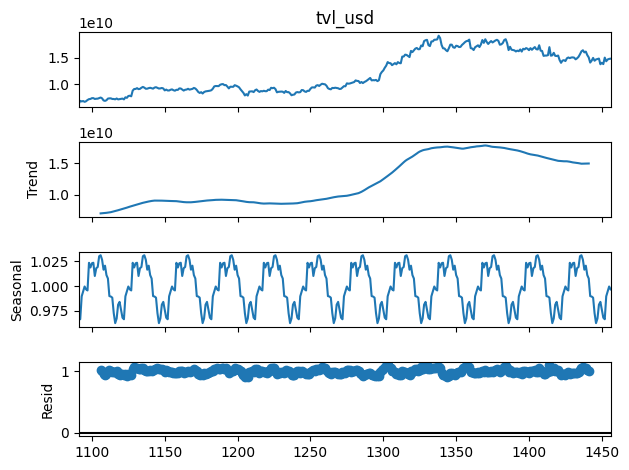

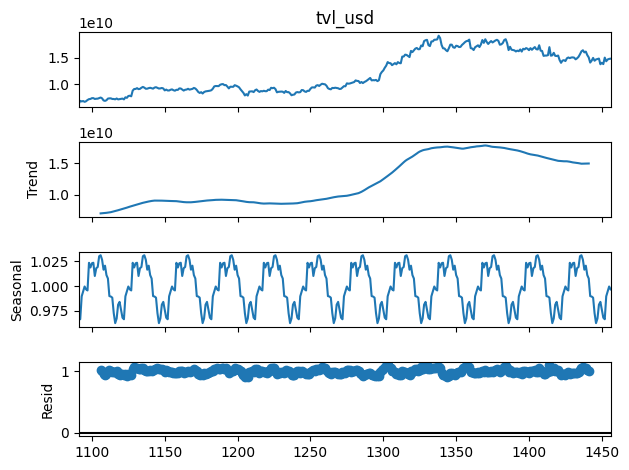

In [14]:
from statsmodels.tsa.seasonal import seasonal_decompose


decomposition = seasonal_decompose(df_final1['tvl_usd'], model= 'multiplicative' , period=30)
decomposition.plot()

In [15]:
seasonal = decomposition.seasonal
seasonal.describe()

count   366
mean      1
std       0
min       1
25%       1
50%       1
75%       1
max       1
Name: seasonal, dtype: float64

In [16]:
seasonal_range = seasonal.max() - seasonal.min()
seasonal_strength = seasonal_range / seasonal.mean()
print(f"Seasonal range: {seasonal_range}")
print(f"Seasonality strength (as %): {seasonal_strength * 100:.2f}%")

Seasonal range: 0.06893401208815286
Seasonality strength (as %): 6.90%


In [17]:
df_final1

,Unnamed: 0,date,tvl_usd
1091,1091,2024-04-14 00:00:00,"6,268,585,859"
1092,1092,2024-04-15 00:00:00,"6,796,970,252"
1093,1093,2024-04-16 00:00:00,"6,692,373,807"
1094,1094,2024-04-17 00:00:00,"6,767,378,856"
1095,1095,2024-04-18 00:00:00,"6,611,529,560"
...,...,...,...
1452,1452,2025-04-10 00:00:00,"15,023,167,027"
1453,1453,2025-04-11 00:00:00,"14,327,943,447"
1454,1454,2025-04-12 00:00:00,"14,667,480,258"
1455,1455,2025-04-13 00:00:00,"14,779,452,887"


In [18]:
hist(df_final1[, "tvl_usd"], 30).show()

In [19]:
hist(diff(df_final1[, "tvl_usd"]), 30) 

In [20]:
# diff histogram
diffs = df_final1['tvl_usd'].diff().dropna()

fig4 = px.histogram(
    x=diffs,
    nbins=30,
    title="Histogram of TVL Daily Differences",
    labels={"x": "Daily TVL Change (USD)"},
)
fig4.update_layout(bargap=0.1)
fig4.show()

In [21]:
# check stationary

from statsmodels.tsa.stattools import adfuller
result = adfuller(df_final1['tvl_usd'].diff().dropna())
print(f"ADF Statistic: {result[0]}")
print(f"p-value: {result[1]}")

ADF Statistic: -20.61676405152838
p-value: 0.0


AttributeError: module 'matplotlib' has no attribute 'xlabel'

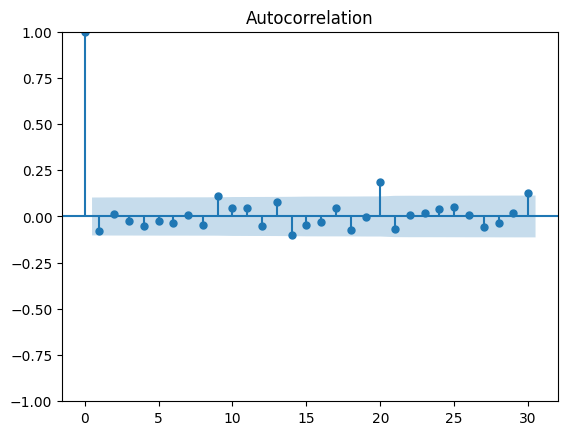

In [22]:
# check self correlation
from statsmodels.graphics.tsaplots import plot_acf

plot_acf(diffs, lags=30)  # lags = چند روز قبل رو بررسی کنیم
#plt.title("Autocorrelation (ACF) of TVL Daily Changes")
plt.xlabel("Lag (days)")
plt.ylabel("Autocorrelation")
plt.grid(True)
plt.show()

AttributeError: module 'matplotlib' has no attribute 'show'

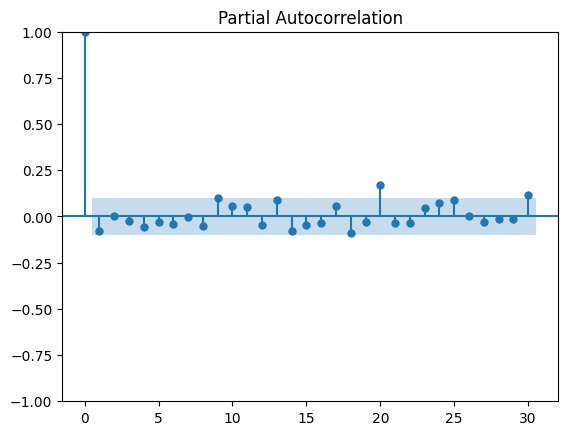

In [23]:
from statsmodels.graphics.tsaplots import plot_pacf
plot_pacf(diffs, lags=30)
plt.show()

# 05. Modeling

In [ ]:
df = df_final1.copy()

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, Dense
from sklearn.metrics import mean_squared_error
import math

df = df.dropna()
df.index = pd.to_datetime(df.index)
df = df.sort_index()


In [ ]:

# فقط ستون TVL
data = df['tvl_usd'].values.reshape(-1, 1)

# نرمال‌سازی
scaler = MinMaxScaler()
data_scaled = scaler.fit_transform(data)

# ------------------------------------------
# 2. ساخت دنباله با look_back = 30
def create_dataset(dataset, look_back=30):
    X, y = [], []
    for i in range(len(dataset) - look_back):
        X.append(dataset[i:i+look_back, 0])
        y.append(dataset[i + look_back, 0])
    return np.array(X), np.array(y)

look_back = 30
X, y = create_dataset(data_scaled, look_back)

# reshape به فرمت [نمونه, زمان, ویژگی]
X = np.reshape(X, (X.shape[0], X.shape[1], 1))

# ------------------------------------------
# 3. تقسیم به train/test
train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

# ------------------------------------------
# 4. ساخت و آموزش مدل RNN
model = Sequential()
model.add(SimpleRNN(128, input_shape=(look_back, 1)))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')

history = model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

# ------------------------------------------
# 5. پیش‌بینی و بازگردانی مقیاس
y_pred_scaled = model.predict(X_test)
y_pred = scaler.inverse_transform(y_pred_scaled)
y_test_actual = scaler.inverse_transform(y_test.reshape(-1, 1))

# ------------------------------------------
# 6. ارزیابی و نمایش نمودار
rmse = math.sqrt(mean_squared_error(y_test_actual, y_pred))
print(f"Test RMSE: {rmse:.2f}")

# ایجاد dataframe برای رسم
dates = df.index[-len(y_test):]
result = pd.DataFrame({
    'Date': dates,
    'Actual TVL': y_test_actual.flatten(),
    'Predicted TVL': y_pred.flatten()
})
result.set_index('Date', inplace=True)

# رسم نمودار
plt.figure(figsize=(12, 5))
plt.plot(result['Actual TVL'], label='Actual TVL', color='black')
plt.plot(result['Predicted TVL'], label='Predicted TVL (RNN)', linestyle='dashed', color='red')
plt.title('TVL Forecasting using SimpleRNN')
plt.xlabel('Date')
plt.ylabel('TVL (USD)')
plt.legend()
plt.tight_layout()
plt.show()

# Test

In [8]:
df_final1.to_csv('/Users/bahareh/Desktop/My_Job/BlochChain/Git/ml-in-crypto/02. Stock Market/time-series-machine-learning/_data/MY_DATA/my_tvl_data.csv')

In [7]:
df_final1 = df_final1.drop(['Unnamed: 0'],axis=1)
df_final1

,date,tvl_usd
1091,2024-04-14 00:00:00,"6,268,585,859"
1092,2024-04-15 00:00:00,"6,796,970,252"
1093,2024-04-16 00:00:00,"6,692,373,807"
1094,2024-04-17 00:00:00,"6,767,378,856"
1095,2024-04-18 00:00:00,"6,611,529,560"
...,...,...
1452,2025-04-10 00:00:00,"15,023,167,027"
1453,2025-04-11 00:00:00,"14,327,943,447"
1454,2025-04-12 00:00:00,"14,667,480,258"
1455,2025-04-13 00:00:00,"14,779,452,887"


# GCP

In [1]:
!pip install google-cloud-bigquery

  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.25.6
    Uninstalling protobuf-4.25.6:
      Successfully uninstalled protobuf-4.25.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.16.2 requires protobuf!=4.21.0,!=4.21.1,!=4.21.2,!=4.21.3,!=4.21.4,!=4.21.5,<5.0.0dev,>=3.20.3, but you have protobuf 5.29.4 which is incompatible.
